Usage example of MediaPipe Hands Solution API in Python (see also http://solutions.mediapipe.dev/hands).

# Using kaggle dataset



In [2]:
# use this part if you want to use kaggle datasets
!pip -q install kaggle 

In [3]:
# use this part if you want to use kaggle datasets
# upload your kaggle token
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"johnlennin","key":"779924dff2c66e198ef5b1c855df549f"}'}

In [4]:
# use this part if you want to use kaggle datasets
!mkdir ~/.kaggle
!cp -v kaggle.json ~/.kaggle 

'kaggle.json' -> '/root/.kaggle/kaggle.json'


In [5]:
# use this part if you want to use kaggle datasets
!chmod 600 ~/.kaggle/kaggle.json  

In [6]:
# use this part if you want to use kaggle datasets
! kaggle datasets download -d idhamozi/indonesian-sign-language-bisindo

100% 888M/890M [00:08<00:00, 108MB/s]
100% 890M/890M [00:08<00:00, 110MB/s]


In [7]:
# use this part if you want to use kaggle datasets
!unzip -q indonesian-sign-language-bisindo.zip 

# Upload your own image

In [10]:
# uncomment this if you want to upload your own images
# from google.colab import files

# uploaded = files.upload()

Upload any image that contains hand(s) to the Colab. We took two examples from the web: https://unsplash.com/photos/QyCH5jwrD_A and https://unsplash.com/photos/tSePVHkxUCk


# Using MediaPipe

In [6]:
!pip -q install mediapipe

In [1]:
# importing stuff
import matplotlib.pyplot as plt
import csv
import os
import cv2
import numpy as np
import mediapipe as mp


All MediaPipe Solutions Python API examples are under mp.solutions.

For the MediaPipe Hands solution, we can access this module as `mp_hands = mp.solutions.hands`.

You may change the parameters, such as `static_image_mode`, `max_num_hands`, and `min_detection_confidence`, during the initialization. Run `help(mp_hands.Hands)` to get more informations about the parameters.

In [2]:
mp_hands = mp.solutions.hands
mp_drawing = mp.solutions.drawing_utils 
help(mp_hands.Hands)

Help on class Hands in module mediapipe.python.solutions.hands:

class Hands(mediapipe.python.solution_base.SolutionBase)
 |  Hands(static_image_mode=False, max_num_hands=2, min_detection_confidence=0.5, min_tracking_confidence=0.5)
 |  
 |  MediaPipe Hands.
 |  
 |  MediaPipe Hands processes an RGB image and returns the hand landmarks and
 |  handedness (left v.s. right hand) of each detected hand.
 |  
 |  Note that it determines handedness assuming the input image is mirrored,
 |  i.e., taken with a front-facing/selfie camera (
 |  https://en.wikipedia.org/wiki/Front-facing_camera) with images flipped
 |  horizontally. If that is not the case, use, for instance, cv2.flip(image, 1)
 |  to flip the image first for a correct handedness output.
 |  
 |  Please refer to https://solutions.mediapipe.dev/hands#python-solution-api for
 |  usage examples.
 |  
 |  Method resolution order:
 |      Hands
 |      mediapipe.python.solution_base.SolutionBase
 |      builtins.object
 |  
 |  Method

# Extracting features

In [9]:
fields = [
    'IMAGE_NAME'               ,
    'LABEL'                    ,
    'RIGHT_HAND_PROB'          ,
    'LEFT_HAND_PROB'           ,
    'RIGHT_X_WRIST'            ,
    'RIGHT_Y_WRIST'            ,
    'RIGHT_Z_WRIST'            ,
    'RIGHT_X_THUMB_CMC'        ,
    'RIGHT_Y_THUMB_CMC'        ,
    'RIGHT_Z_THUMB_CMC'        ,
    'RIGHT_X_THUMB_MCP'        ,
    'RIGHT_Y_THUMB_MCP'        ,
    'RIGHT_Z_THUMB_MCP'        ,
    'RIGHT_X_THUMB_IP'         ,
    'RIGHT_Y_THUMB_IP'         ,
    'RIGHT_Z_THUMB_IP'         ,
    'RIGHT_X_THUMB_TIP'        ,
    'RIGHT_Y_THUMB_TIP'        ,
    'RIGHT_Z_THUMB_TIP'        ,
    'RIGHT_X_INDEX_FINGER_MCP' ,
    'RIGHT_Y_INDEX_FINGER_MCP' ,
    'RIGHT_Z_INDEX_FINGER_MCP' ,
    'RIGHT_X_INDEX_FINGER_PIP' ,
    'RIGHT_Y_INDEX_FINGER_PIP' ,
    'RIGHT_Z_INDEX_FINGER_PIP' ,
    'RIGHT_X_INDEX_FINGER_DIP' ,
    'RIGHT_Y_INDEX_FINGER_DIP' ,
    'RIGHT_Z_INDEX_FINGER_DIP' ,
    'RIGHT_X_INDEX_FINGER_TIP' ,
    'RIGHT_Y_INDEX_FINGER_TIP' ,
    'RIGHT_Z_INDEX_FINGER_TIP' ,
    'RIGHT_X_MIDDLE_FINGER_MCP',
    'RIGHT_Y_MIDDLE_FINGER_MCP',
    'RIGHT_Z_MIDDLE_FINGER_MCP',
    'RIGHT_X_MIDDLE_FINGER_PIP',
    'RIGHT_Y_MIDDLE_FINGER_PIP',
    'RIGHT_Z_MIDDLE_FINGER_PIP',
    'RIGHT_X_MIDDLE_FINGER_DIP',
    'RIGHT_Y_MIDDLE_FINGER_DIP',
    'RIGHT_Z_MIDDLE_FINGER_DIP',
    'RIGHT_X_MIDDLE_FINGER_TIP',
    'RIGHT_Y_MIDDLE_FINGER_TIP',
    'RIGHT_Z_MIDDLE_FINGER_TIP',
    'RIGHT_X_RING_FINGER_MCP'  ,
    'RIGHT_Y_RING_FINGER_MCP'  ,
    'RIGHT_Z_RING_FINGER_MCP'  ,
    'RIGHT_X_RING_FINGER_PIP'  ,
    'RIGHT_Y_RING_FINGER_PIP'  ,
    'RIGHT_Z_RING_FINGER_PIP'  ,
    'RIGHT_X_RING_FINGER_DIP'  ,
    'RIGHT_Y_RING_FINGER_DIP'  ,
    'RIGHT_Z_RING_FINGER_DIP'  ,
    'RIGHT_X_RING_FINGER_TIP'  ,
    'RIGHT_Y_RING_FINGER_TIP'  ,
    'RIGHT_Z_RING_FINGER_TIP'  ,
    'RIGHT_X_PINKY_MCP'        ,
    'RIGHT_Y_PINKY_MCP'        ,
    'RIGHT_Z_PINKY_MCP'        ,
    'RIGHT_X_PINKY_PIP'        ,
    'RIGHT_Y_PINKY_PIP'        ,
    'RIGHT_Z_PINKY_PIP'        ,
    'RIGHT_X_PINKY_DIP'        ,
    'RIGHT_Y_PINKY_DIP'        ,
    'RIGHT_Z_PINKY_DIP'        ,
    'RIGHT_X_PINKY_TIP'        ,
    'RIGHT_Y_PINKY_TIP'        ,
    'RIGHT_Z_PINKY_TIP'        ,
    'LEFT_X_WRIST'            ,
    'LEFT_Y_WRIST'            ,
    'LEFT_Z_WRIST'            ,
    'LEFT_X_THUMB_CMC'        ,
    'LEFT_Y_THUMB_CMC'        ,
    'LEFT_Z_THUMB_CMC'        ,
    'LEFT_X_THUMB_MCP'        ,
    'LEFT_Y_THUMB_MCP'        ,
    'LEFT_Z_THUMB_MCP'        ,
    'LEFT_X_THUMB_IP'         ,
    'LEFT_Y_THUMB_IP'         ,
    'LEFT_Z_THUMB_IP'         ,
    'LEFT_X_THUMB_TIP'        ,
    'LEFT_Y_THUMB_TIP'        ,
    'LEFT_Z_THUMB_TIP'        ,
    'LEFT_X_INDEX_FINGER_MCP' ,
    'LEFT_Y_INDEX_FINGER_MCP' ,
    'LEFT_Z_INDEX_FINGER_MCP' ,
    'LEFT_X_INDEX_FINGER_PIP' ,
    'LEFT_Y_INDEX_FINGER_PIP' ,
    'LEFT_Z_INDEX_FINGER_PIP' ,
    'LEFT_X_INDEX_FINGER_DIP' ,
    'LEFT_Y_INDEX_FINGER_DIP' ,
    'LEFT_Z_INDEX_FINGER_DIP' ,
    'LEFT_X_INDEX_FINGER_TIP' ,
    'LEFT_Y_INDEX_FINGER_TIP' ,
    'LEFT_Z_INDEX_FINGER_TIP' ,
    'LEFT_X_MIDDLE_FINGER_MCP',
    'LEFT_Y_MIDDLE_FINGER_MCP',
    'LEFT_Z_MIDDLE_FINGER_MCP',
    'LEFT_X_MIDDLE_FINGER_PIP',
    'LEFT_Y_MIDDLE_FINGER_PIP',
    'LEFT_Z_MIDDLE_FINGER_PIP',
    'LEFT_X_MIDDLE_FINGER_DIP',
    'LEFT_Y_MIDDLE_FINGER_DIP',
    'LEFT_Z_MIDDLE_FINGER_DIP',
    'LEFT_X_MIDDLE_FINGER_TIP',
    'LEFT_Y_MIDDLE_FINGER_TIP',
    'LEFT_Z_MIDDLE_FINGER_TIP',
    'LEFT_X_RING_FINGER_MCP'  ,
    'LEFT_Y_RING_FINGER_MCP'  ,
    'LEFT_Z_RING_FINGER_MCP'  ,
    'LEFT_X_RING_FINGER_PIP'  ,
    'LEFT_Y_RING_FINGER_PIP'  ,
    'LEFT_Z_RING_FINGER_PIP'  ,
    'LEFT_X_RING_FINGER_DIP'  ,
    'LEFT_Y_RING_FINGER_DIP'  ,
    'LEFT_Z_RING_FINGER_DIP'  ,
    'LEFT_X_RING_FINGER_TIP'  ,
    'LEFT_Y_RING_FINGER_TIP'  ,
    'LEFT_Z_RING_FINGER_TIP'  ,
    'LEFT_X_PINKY_MCP'        ,
    'LEFT_Y_PINKY_MCP'        ,
    'LEFT_Z_PINKY_MCP'        ,
    'LEFT_X_PINKY_PIP'        ,
    'LEFT_Y_PINKY_PIP'        ,
    'LEFT_Z_PINKY_PIP'        ,
    'LEFT_X_PINKY_DIP'        ,
    'LEFT_Y_PINKY_DIP'        ,
    'LEFT_Z_PINKY_DIP'        ,
    'LEFT_X_PINKY_TIP'        ,
    'LEFT_Y_PINKY_TIP'        ,
    'LEFT_Z_PINKY_TIP'        ,
]

# array for storing data 
landmark = []

# array for storing error data that can be used for debugging
errorimg = []



In [4]:
def assign(name, label, handed, position):
    temp = np.zeros(130).tolist()
    temp[0:2] = [name, label]
    # if we detect one hands only
    if len(handed) == 1:
        if handed[0][0] == 0:
            temp[2:3] = [handed[0][1]]
            temp[4:67] = position[0:63]
        elif handed[0][0] == 1:
            temp[3:4] = [handed[0][1]]
            temp[67:130] = position[0:63]
    # if we detect both hand with different handedness
    elif handed[0][0] != handed [1][0]:
        for i, hand in enumerate(handed):  
            if hand[0] == 0:
                temp[2:3] = [hand[1]]
                if i == 0:
                    temp[4:67] = position[0:63]
                elif i == 1:
                    temp[4:67] = position[63:130]
            elif hand[0] == 1:
                temp[3:4] = [hand[1]]
                if i == 0:
                    temp[67:130] = position[0:63]
                elif i == 1:
                    temp[67:130] = position[63:130]
    # if we detect both hands but in the same handedness
    # we'll pick the one with greater probability
    else:
        if handed[0][1] > handed[1][1]:
            if handed[0][0] == 0:
                temp[2:3] = [handed[0][1]]
                temp[4:67] = position[0:63]

            elif handed[0][0] == 1:
                temp[3:4] = [handed[0][1]]
                temp[67:130] = position[0:63]
        else:
            if handed[1][0] == 0:
                temp[2:3] = [handed[1][1]]
                temp[4:67] = position[63:130]
            elif handed[1][0] == 1:
                temp[3:4] = [handed[1][1]]
                temp[67:130] = position[63:130]
    return temp   

In [5]:
def show_img(image, results = None, flip=False):
    if flip :
        annotated_image = cv2.flip(image.copy(),1)
    else : 
        annotated_image = image.copy()
   
    height, width, _ = image.shape
    if results != None:
        for hand_landmarks in results.multi_hand_landmarks:
        # Print index finger tip coordinates.

            mp_drawing.draw_landmarks(
                annotated_image, hand_landmarks, mp_hands.HAND_CONNECTIONS)


    %matplotlib inline
    # What size does the figure need to be in inches to fit the image?
    dpi = 80
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image
    ax.imshow(annotated_image)
    plt.show()

In [10]:
# the letter represent the type of image we want to predict
# you can change pathe datatrain to datatest or vice versa
for letter in 'ABCDEFGHIJKLMNOPQRSTUVWXYZ':
    imgpath = 'Dataset BISINDO'+'/datatrain/'+letter
    imglist = os.listdir(imgpath)
    print(letter)
    images = {name: cv2.imread(imgpath+'/'+name) for name in imglist}
    #you can tweak the confidence parameter, we will use smaller number so we    can see all the possibilities
    with mp_hands.Hands(
        static_image_mode=True,
        max_num_hands=2,
        min_detection_confidence=0.1) as hands:
        for name, image in images.items():
            # Convert the BGR image to RGB, flip the image around y-axis for correct 
            # handedness output and process it with MediaPipe Hands.
            
            # use cv2.flip if your picture taken from front camera
            # results = hands.process(cv2.flip(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), 1))
            results = hands.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            # Check if theres hand available
            if not results.multi_hand_landmarks:
                continue
                
            # using multi_handedness API to detect probabilty of each hand
            # isRight = False
            # isLeft = False
            handed = []
            for res in results.multi_handedness:
                if res.classification[0].label == 'Right':
                    handed.append([0,res.classification[0].score])
                elif res.classification[0].label == 'Left':
                    handed.append([1,res.classification[0].score])                    
            # using multi_hand_landmarks API to detect the coordinate of the hands in 2.5D
            position = []
            # looping both hands
            for hand_landmarks in results.multi_hand_landmarks:
            # Print index finger tip coordinates.
                #looping 21 landmark *3 (x,y,z) 126
                for point in list(hand_landmarks.landmark):
                    position.append(point.x)
                    position.append(point.y)
                    position.append(point.z)
            temp = assign(name, letter, handed, position)
            landmark.append(temp)


A
B
C
D
E
F
G
H
I
J
K
L
M
N
O
P
Q
R
S
T
U
V
W
X
Y
Z


In [11]:
#edit this code to chose what file to be written
with open('train.csv', 'w') as f:
      
    # using csv.writer method from CSV package
    write = csv.writer(f)
      
    write.writerow(fields)
    write.writerows(landmark)

# Debug Each Image

display each image which have been misclassified

Handedness of IMG_0726.JPG:
[classification {
  index: 1
  score: 0.9850573539733887
  label: "Right"
}
, classification {
  index: 0
  score: 0.9998076558113098
  label: "Left"
}
]


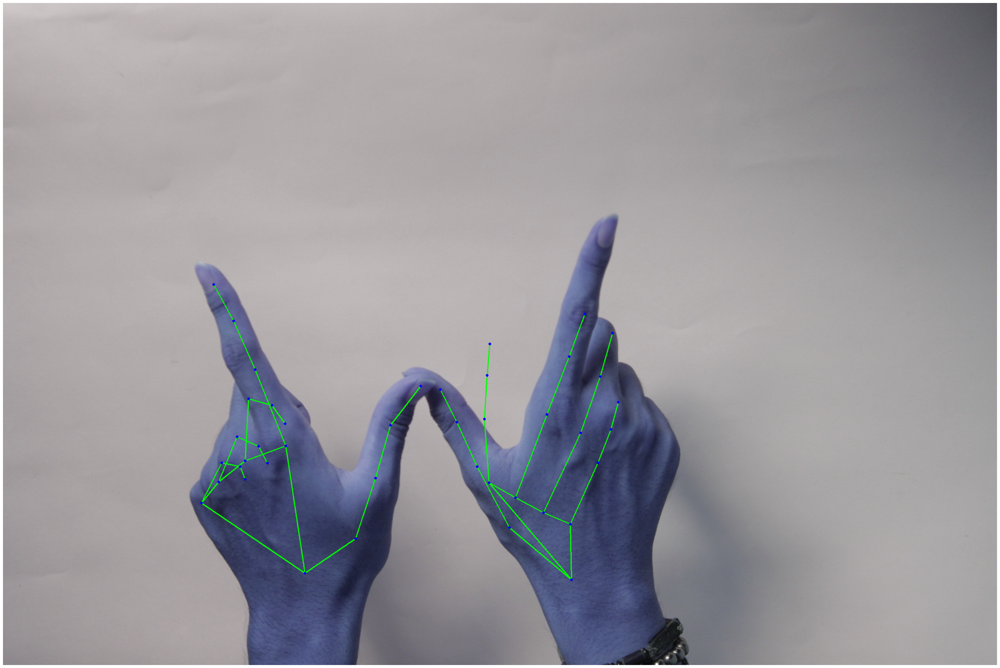

Handedness of IMG_0724.JPG:
None
Handedness of IMG_0723.JPG:
[classification {
  index: 0
  score: 0.9999999403953552
  label: "Left"
}
, classification {
  index: 1
  score: 0.8855963349342346
  label: "Right"
}
]


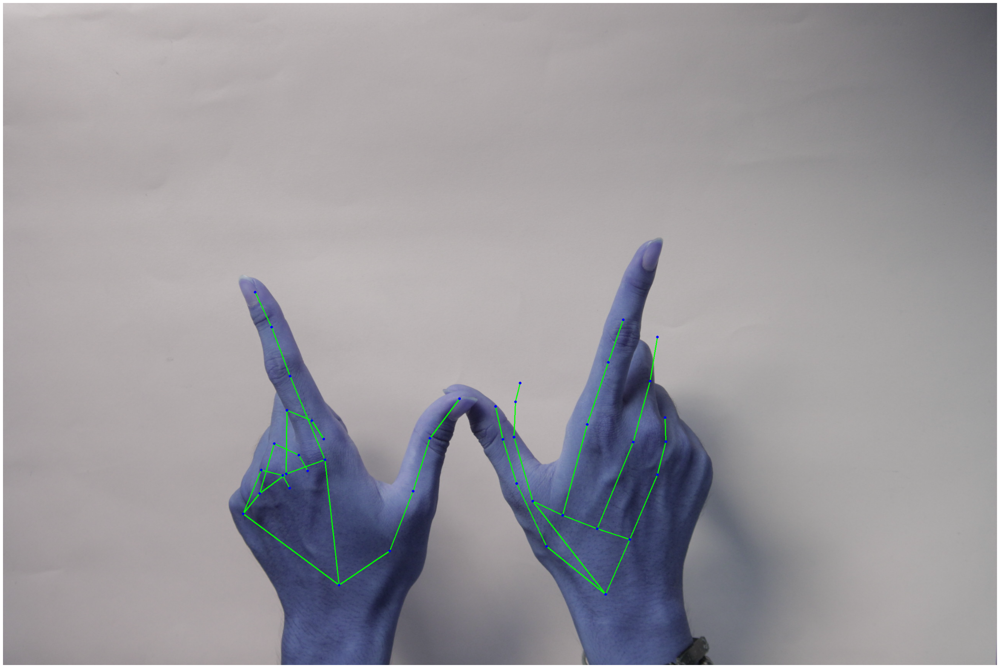

Handedness of IMG_0735.JPG:
None
Handedness of IMG_0722.JPG:
[classification {
  index: 0
  score: 0.9916592240333557
  label: "Left"
}
, classification {
  index: 0
  score: 0.9979506731033325
  label: "Left"
}
]


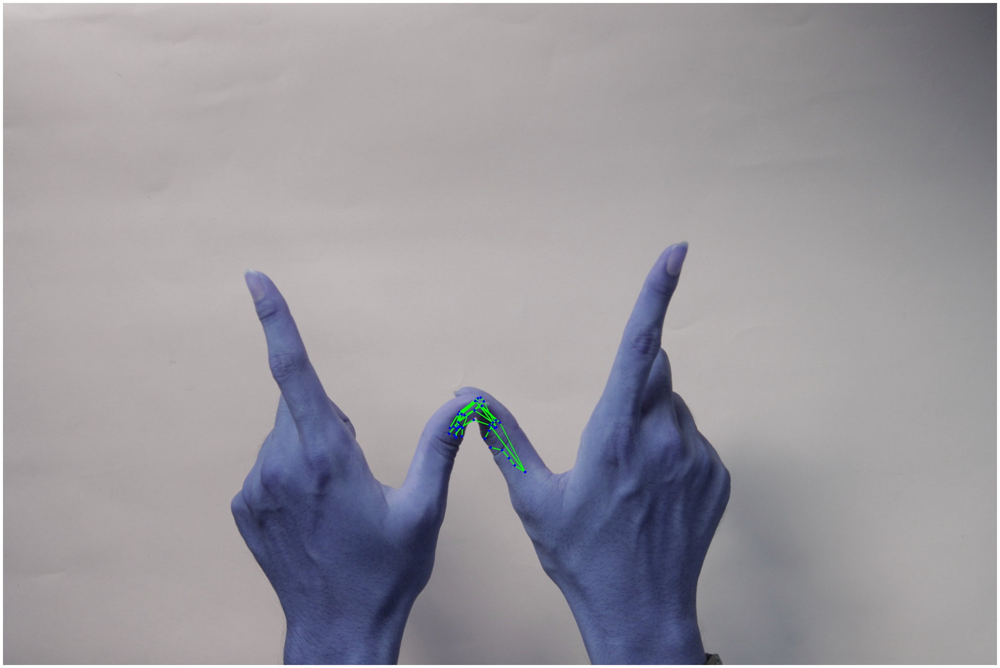

Handedness of IMG_0734.JPG:
[classification {
  index: 1
  score: 0.9999929070472717
  label: "Right"
}
, classification {
  index: 0
  score: 0.8616830110549927
  label: "Left"
}
]


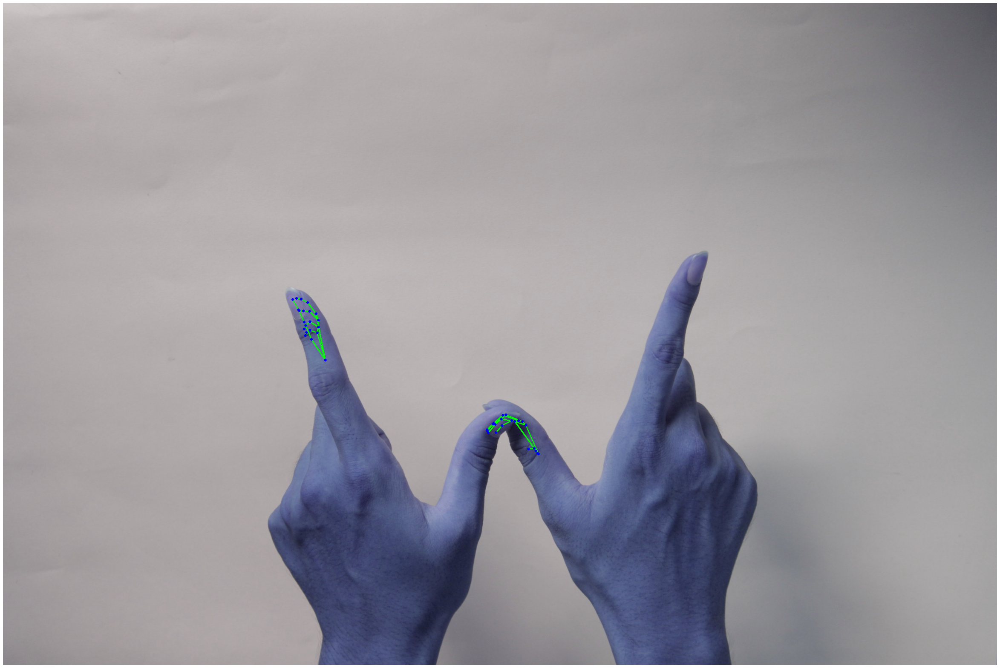

In [34]:
with mp_hands.Hands(
static_image_mode=True,
max_num_hands=2,
min_detection_confidence=0.1) as hands:
    i = 0
    # name = 'IMG_0723.JPG'
    letter = 'W'
    imgpath = 'Dataset BISINDO'+'/datatest/'+letter
    imglist = os.listdir(imgpath)
    images = {name: cv2.imread(imgpath+'/'+name) for name in imglist}
    for name, image in images.items():
        # Convert the BGR image to RGB, flip the image around y-axis for correct 
        # handedness output and process it with MediaPipe Hands.
        
        # use cv2.flip if your picture taken from front camera
        results = hands.process(cv2.flip(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), 1))
        # results = hands.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    
        # Print handedness (left v.s. right hand).
        print(f'Handedness of {name}:')
        print(results.multi_handedness)

        if not results.multi_hand_landmarks:
            continue
        show_img(image, results=results, flip=True)
        if i == 3:
            break;
        i += 1



Handedness of IMG_0726.JPG:
[classification {
  index: 1
  score: 0.9979029297828674
  label: "Right"
}
, classification {
  index: 1
  score: 0.6852781176567078
  label: "Right"
}
]


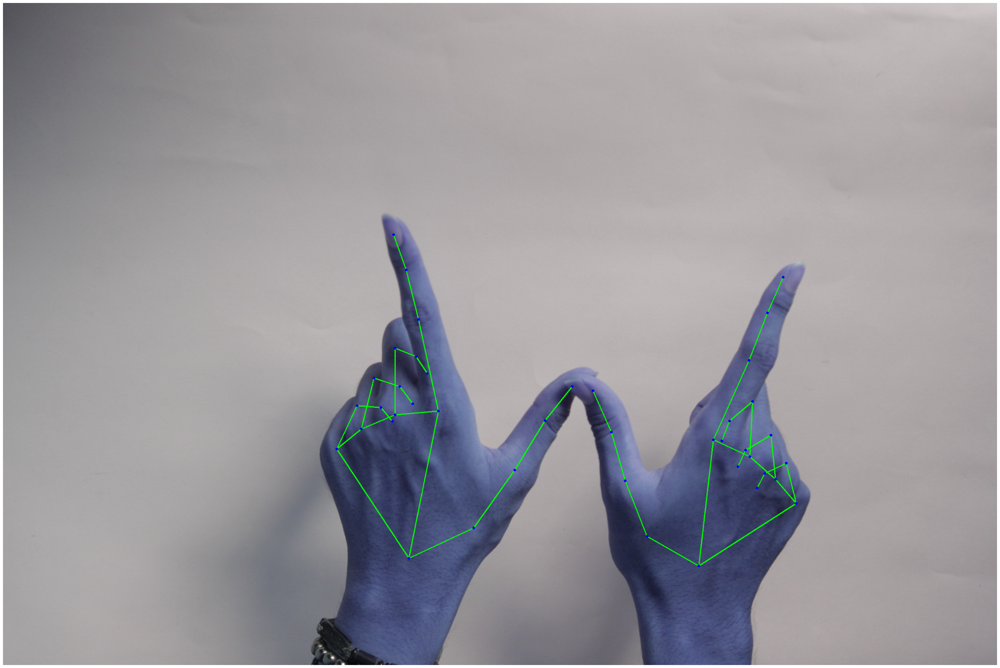

Handedness of IMG_0724.JPG:
[classification {
  index: 1
  score: 0.9816905856132507
  label: "Right"
}
]


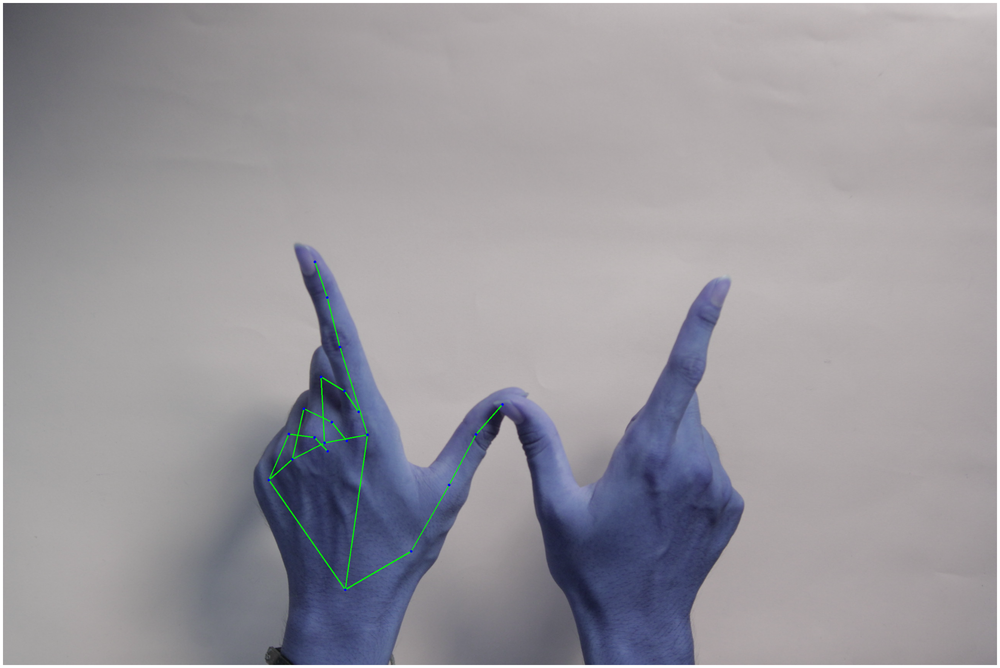

Handedness of IMG_0723.JPG:
[classification {
  index: 0
  score: 0.5763353705406189
  label: "Left"
}
, classification {
  index: 1
  score: 0.9883548021316528
  label: "Right"
}
]


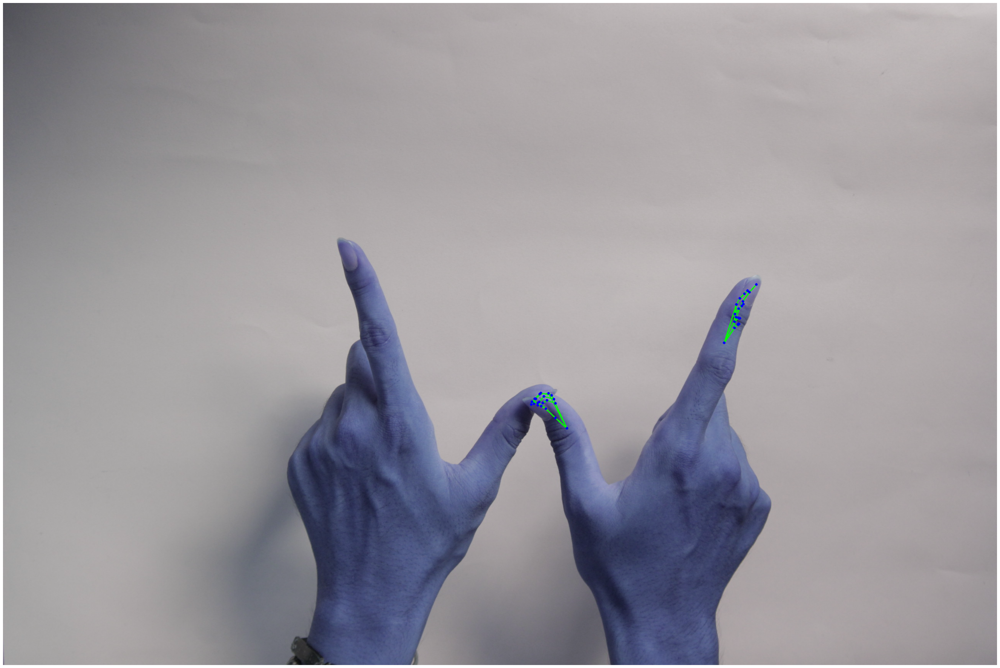

Handedness of IMG_0735.JPG:
[classification {
  index: 1
  score: 0.9998595118522644
  label: "Right"
}
]


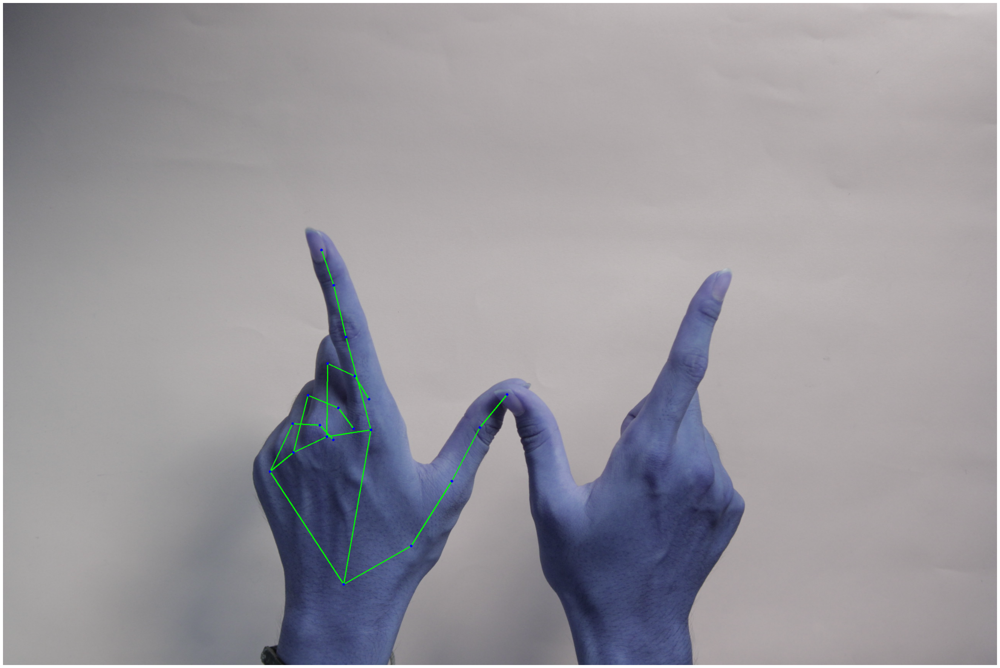

In [35]:
with mp_hands.Hands(
static_image_mode=True,
max_num_hands=2,
min_detection_confidence=0.1) as hands:
    i = 0
    # name = 'IMG_0723.JPG'
    letter = 'W'
    imgpath = 'Dataset BISINDO'+'/datatest/'+letter
    imglist = os.listdir(imgpath)
    images = {name: cv2.imread(imgpath+'/'+name) for name in imglist}
    for name, image in images.items():
        # Convert the BGR image to RGB, flip the image around y-axis for correct 
        # handedness output and process it with MediaPipe Hands.
        
        # use cv2.flip if your picture taken from front camera
        # results = hands.process(cv2.flip(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), 1))
        results = hands.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    
        # Print handedness (left v.s. right hand).
        print(f'Handedness of {name}:')
        print(results.multi_handedness)

        if not results.multi_hand_landmarks:
            continue
        show_img(image, results=results)
        if i == 3:
            break;
        i += 1

In [28]:
letter = 'W'
imgpath = 'Dataset BISINDO'+'/datatest/'+letter
imglist = os.listdir(imgpath)
images = {name: imgpath+'/'+name for name in imglist}
# images = {name: cv2.imread(imgpath+'/'+name) for name in imglist}
# name = 'IMG_0723.JPG'
# imgpath = 'Datset BISINDO'+'/datatest/'+letter+'/'+name
# images = {name: imgpath}
for name, image in images.items():
    print(name, image)
    # show_img(image)
    break;

IMG_0726.JPG Dataset BISINDO/datatest/W/IMG_0726.JPG


Each letter image will be shown

In [35]:

with mp_hands.Hands(
static_image_mode=True,
max_num_hands=2,
min_detection_confidence=0.1) as hands:
    for letter in "ABCDEFGHIJKLMNOPQRSTUVWXYZ":
        imgpath = 'Dataset BISINDO'+'/datatrain/'+letter
        imglist = os.listdir(imgpath)
        print(letter)
        images = {name: cv2.imread(imgpath+'/'+name) for name in imglist}
        for name, image in images.items():
            # Convert the BGR image to RGB, flip the image around y-axis for correct 
            # handedness output and process it with MediaPipe Hands.
            
            # use cv2.flip if your picture taken from front camera
            # results = hands.process(cv2.flip(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), 1))
            results = hands.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            
            height, width, _ = image.shape
            # Print handedness (left v.s. right hand).
            print(f'Handedness of {name}:')
            print(results.multi_handedness)

            # Draw hand landmarks of each hand.
            print(f'Hand landmarks of {name}:')
            if not results.multi_hand_landmarks:
                continue
            # use cv2.flip if your picture taken from front camera
            # annotated_image = cv2.flip(image.copy(), 1)
            annotated_image = image.copy()
            for hand_landmarks in results.multi_hand_landmarks:
            # Print index finger tip coordinates.
            
                mp_drawing.draw_landmarks(
                    annotated_image, hand_landmarks, mp_hands.HAND_CONNECTIONS)
            
            
            %matplotlib inline
            # What size does the figure need to be in inches to fit the image?
            dpi = 80
            figsize = width / float(dpi), height / float(dpi)

            # Create a figure of the right size with one axes that takes up the full figure
            fig = plt.figure(figsize=figsize)
            ax = fig.add_axes([0, 0, 1, 1])

            # Hide spines, ticks, etc.
            ax.axis('off')

            # Display the image
            ax.imshow(annotated_image)
            plt.show()
            break;

IndentationError: unexpected indent (<ipython-input-35-d587ce5d44ac>, line 10)